## **Part 1 - Similar Image Recommendation**


**Objective** : 

Our goal is to recommend the most similar outfits based on users choice of clothing using Content-Based filtering, based on the description of an item and a profile of the user’s preferred choices.

In this recommendation system, features are used to describe the items. The algorithms try to recommend products that are similar to the ones that a user has liked in the past.

We will use K-Nearest Neighbours algorithms to recommend products which have visually similar features, such as the ones we see in shopping websites e.g. "Products that are similar to this".


**Note : Rerunning the file might take 8 hours as extracting features takes a lot of time.**

## Downloading dataset

Lets first merge the image data and product meta data to get the required dataset.

We will look at some of the categories and subcategories to understand which categories are more dominant.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


**Note:  Commenting out the downloading and unzipping of dataset and we have done it once and do not want it to run again.**




In [ ]:
import os
#os.environ['KAGGLE_CONFIG_DIR'] = '/content/gdrive/MyDrive/kaggle-dataset'

In [ ]:
#%cd /content/gdrive/MyDrive/kaggle-dataset

In [ ]:
#ls

In [ ]:
#!kaggle datasets download -d paramaggarwal/fashion-product-images-small

100% 564M/565M [00:08<00:00, 65.6MB/s]
100% 565M/565M [00:08<00:00, 70.5MB/s]


In [ ]:
#!mkdir fashion-product-images-small
#!mv fashion-product-images-small.zip fashion-product-images-small

In [ ]:
#%cd fashion-product-images-small

/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small


In [ ]:
#!unzip fashion-product-images-small.zip

Streaming output truncated to the last 5000 lines.
  inflating: myntradataset/images/5813.jpg  
  inflating: myntradataset/images/58131.jpg  
  inflating: myntradataset/images/58132.jpg  
  inflating: myntradataset/images/58133.jpg  
  inflating: myntradataset/images/58135.jpg  
  inflating: myntradataset/images/58136.jpg  
  inflating: myntradataset/images/58137.jpg  
  inflating: myntradataset/images/58138.jpg  
  inflating: myntradataset/images/58139.jpg  
  inflating: myntradataset/images/5814.jpg  
  inflating: myntradataset/images/58140.jpg  
  inflating: myntradataset/images/58141.jpg  
  inflating: myntradataset/images/58143.jpg  
  inflating: myntradataset/images/58144.jpg  
  inflating: myntradataset/images/58145.jpg  
  inflating: myntradataset/images/58146.jpg  
  inflating: myntradataset/images/58147.jpg  
  inflating: myntradataset/images/58148.jpg  
  inflating: myntradataset/images/58149.jpg  
  inflating: myntradataset/images/5815.jpg  
  inflating: myntradataset/image

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

***Note : After successfullly mounting the drive, please add a shortcut of this folder (link below) in your drive (MyDrive) to successfully import datasets.***

Dataset contains 44K images which takes lot of time to retrive from shared folder, hence this hack works just fine.

kaggle-dataset : https://drive.google.com/drive/folders/1HpLO2W5YMo1XV5QP7Q7ukSQBTRhG1-V0?usp=sharing

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small/images/1163.jpg')

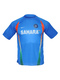

In [ ]:
cv2_imshow(img)

In [ ]:
import numpy as np
import pandas as pd
import os
import re
import tensorflow as tf
from threading import Thread
import time
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.offline import init_notebook_mode
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import Sequence
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.applications import VGG16, ResNet50, DenseNet201, Xception
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

init_notebook_mode(connected=True)

In [ ]:
ls

gdrive/  sample_data/


In [ ]:
images_df = pd.read_csv("/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small/images.csv")

In [ ]:
styles_df = pd.read_csv("/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small/myntradataset/styles.csv",on_bad_lines='skip')

In [ ]:
images_df['id'] = images_df['filename'].apply(lambda x: x.replace(".jpg","")).astype(int)

In [ ]:
images_df

,filename,link,id
0,15970.jpg,http://assets.myntassets.com/v1/images/style/p...,15970
1,39386.jpg,http://assets.myntassets.com/v1/images/style/p...,39386
2,59263.jpg,http://assets.myntassets.com/v1/images/style/p...,59263
3,21379.jpg,http://assets.myntassets.com/v1/images/style/p...,21379
4,53759.jpg,http://assets.myntassets.com/v1/images/style/p...,53759
...,...,...,...
44441,17036.jpg,http://assets.myntassets.com/v1/images/style/p...,17036
44442,6461.jpg,http://assets.myntassets.com/v1/images/style/p...,6461
44443,18842.jpg,http://assets.myntassets.com/v1/images/style/p...,18842
44444,46694.jpg,http://assets.myntassets.com/v1/images/style/p...,46694


In [ ]:
data = styles_df.merge(images_df,on='id',how='left').reset_index(drop=True)
data['filename'] = data['filename'].apply(lambda x: os.path.join("/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small/images",x))

In [ ]:
image_files = os.listdir("/content/gdrive/MyDrive/kaggle-dataset/fashion-product-images-small/images")

In [ ]:
data['file_found'] = data['id'].apply(lambda x: f"{x}.jpg" in image_files)

In [ ]:
data = data[data['file_found']].reset_index(drop=True)

In [ ]:
data.head()

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link,file_found
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,/content/gdrive/MyDrive/kaggle-dataset/fashion...,http://assets.myntassets.com/v1/images/style/p...,True
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,/content/gdrive/MyDrive/kaggle-dataset/fashion...,http://assets.myntassets.com/v1/images/style/p...,True
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,/content/gdrive/MyDrive/kaggle-dataset/fashion...,http://assets.myntassets.com/v1/images/style/p...,True
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,/content/gdrive/MyDrive/kaggle-dataset/fashion...,http://assets.myntassets.com/v1/images/style/p...,True
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,/content/gdrive/MyDrive/kaggle-dataset/fashion...,http://assets.myntassets.com/v1/images/style/p...,True


In [ ]:
data.isnull().sum()

id                      0
gender                  0
masterCategory          0
subCategory             0
articleType             0
baseColour             15
season                 21
year                    1
usage                 317
productDisplayName      7
filename                0
link                    0
file_found              0
dtype: int64

## Visualization

- Main Categories Count
- Sub Categories Count
- Products by Season Count
- Product Usage type Count


**Note** : Attaching the screenshot of the visualizing graphs as after the runtime disconnected its not rendering again and re-running the entire file takes a lot of time.

In [ ]:
fig = px.bar(data.groupby('masterCategory').count().reset_index(), x='masterCategory',y='id',title='Count per Product Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})


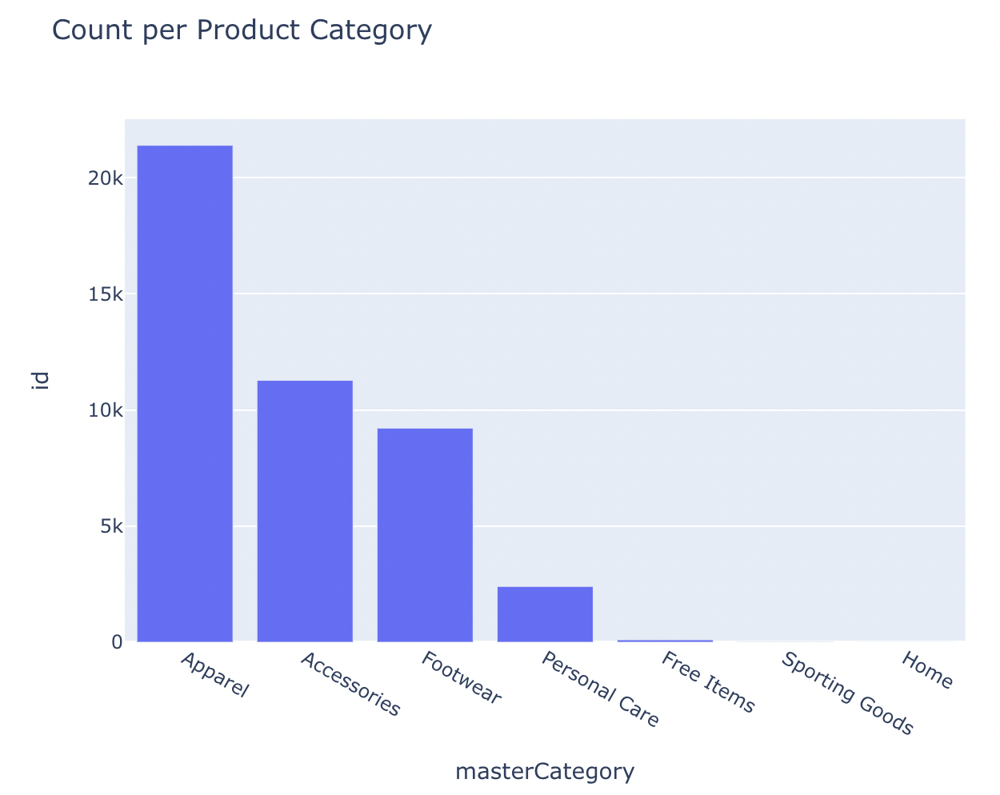

In [ ]:
fig = px.bar(data.groupby('subCategory').count().reset_index(), x='subCategory',y='id',title='Count per Product Sub-category', color='subCategory')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

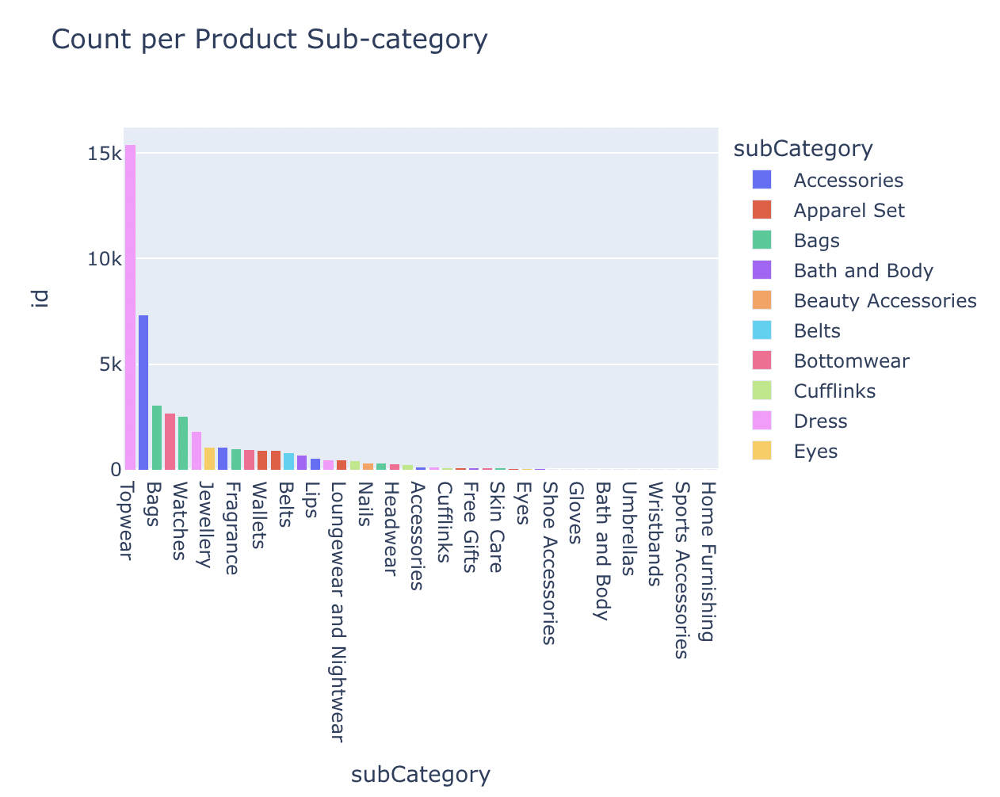

In [ ]:
fig = px.bar(data.groupby('season').count().reset_index(), x='season', y='id', title='Count per Season Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

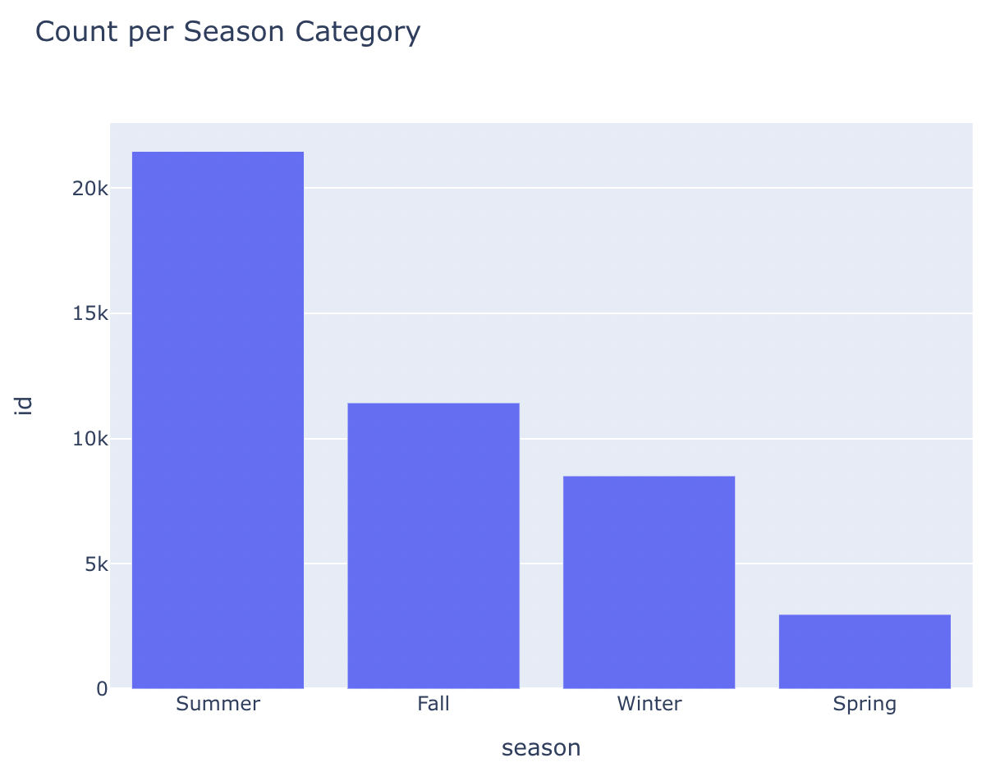

In [ ]:
fig = px.bar(data.groupby('usage').count().reset_index(), x='usage', y='id', title='Count per Usage Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})


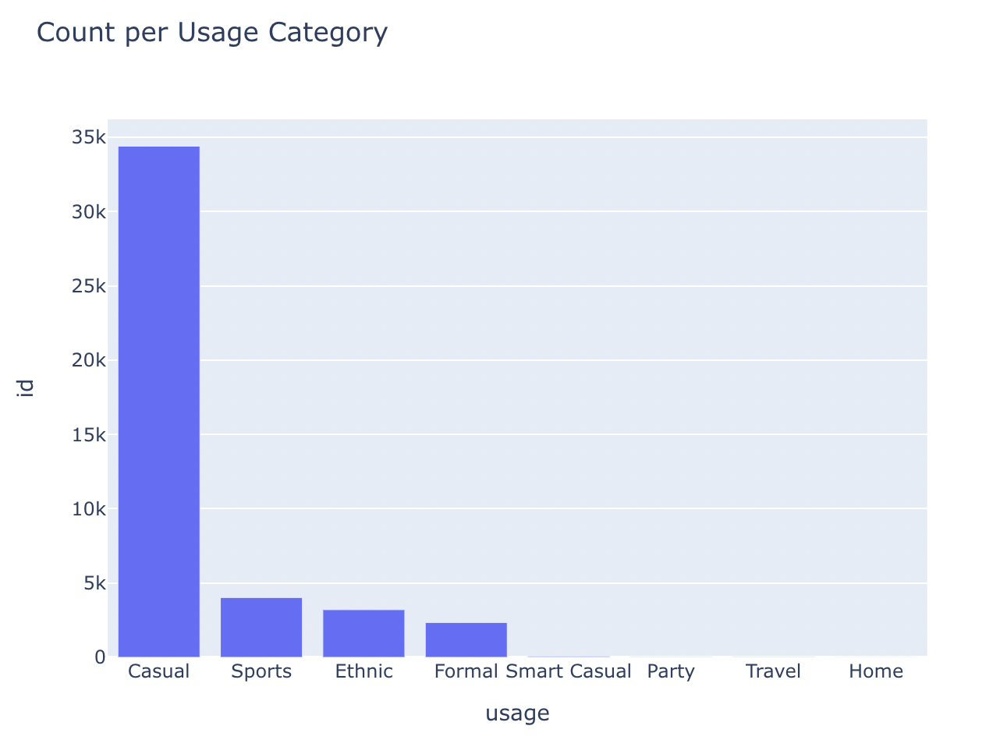

## Removing Unncesary column



In [ ]:
data.drop(columns=['productDisplayName','link','file_found'],inplace=True)
data

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,filename
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
...,...,...,...,...,...,...,...,...,...,...
44414,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
44415,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
44416,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...
44417,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,/content/gdrive/MyDrive/kaggle-dataset/fashion...


## Train-Val Split

In [ ]:
data = data.sample(frac=1).reset_index(drop=True)
n = len(data)
train = data.iloc[:int(n*0.8),:]
val = data.iloc[int(n*0.8):,:].reset_index(drop=True)

In [ ]:
datagen = ImageDataGenerator(rescale=1/255.)

train_generator = datagen.flow_from_dataframe(dataframe=train,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

val_generator = datagen.flow_from_dataframe(dataframe=val,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

/usr/local/lib/python3.7/dist-packages/keras/preprocessing/image.py:932: UserWarning:

`classes` will be ignored given the class_mode="None"



Found 35535 validated image filenames.
Found 8884 validated image filenames.


## Feature Extraction

We will extract the features of the image using the pre-trained deep neural VGG16 network
We will extract the final features of the network by using global average pooling on the final convolutional block of the network

In [ ]:
base_model = VGG16(include_top=False,input_shape=(256,256,3))

model = Sequential()
for layer in base_model.layers:
    model.add(layer)
model.add(GlobalAveragePooling2D())
model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0         
                                                         

### Extracting Features of Training and Validation Set

In [ ]:
train_features = model.predict(train_generator,verbose=1)
val_features = model.predict(val_generator,verbose=1)

278/278 [==============================] - 6065s 22s/step


In [ ]:
import pickle


In [ ]:
with open('train_features', 'wb') as files:
    pickle.dump(train_features, files)

In [ ]:
with open('val_features', 'wb') as files:
    pickle.dump(val_features, files)

## Dimensionality Reduction

The features extracted using the VGG16 Network product is a vector of 512 features. So if we have lets say 10000 products the matrix of our data will be of the dimension 10000 x 512

First 313 Principal Components give 99% of the variance in data so we will reduce the image feature dimensions to 313

**Note** : Attaching the screenshot of the PCA scatter plots as after the runtime disconnected its not rendering again and re-running the entire file takes a lot of time.

In [ ]:
from sklearn.decomposition import PCA  

In [ ]:
pca = PCA(2)
pca.fit(train_features)
train_pca = pca.transform(train_features)

In [ ]:
test_pca = pca.fit_transform(val_features)

In [ ]:
train_pca = pd.DataFrame(train_pca)
train = train.iloc[:,0:10]
train = train.merge(train_pca, how='left', left_index=True, right_index=True)

In [ ]:
fig = px.scatter(train, x=0, y=1, color="masterCategory", title='Main Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

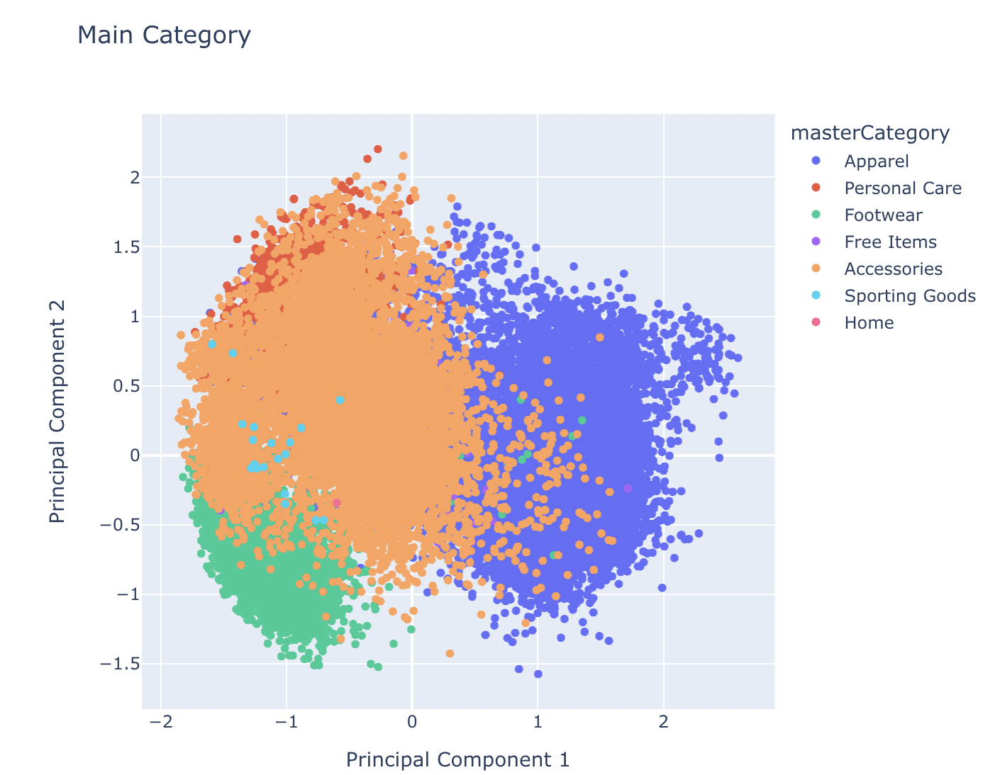

In [ ]:
fig = px.scatter(train, x=0, y=1, color="gender", title='Gender', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

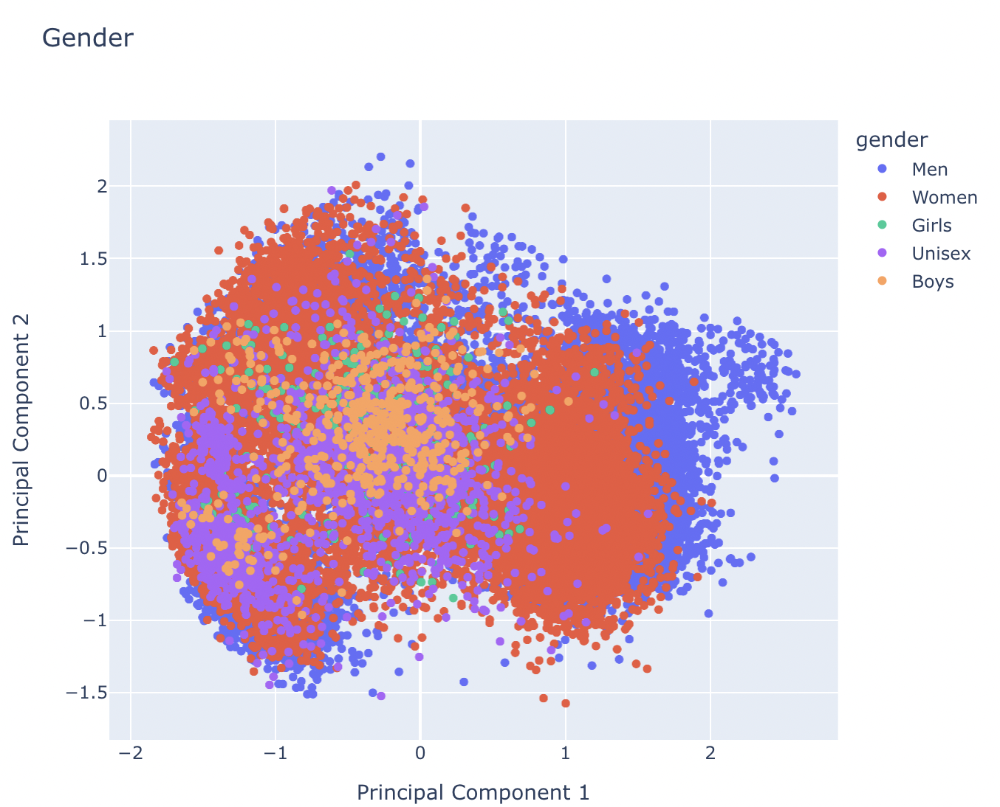

In [ ]:
fig = px.scatter(train, x=0, y=1, color="subCategory", title='Sub Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

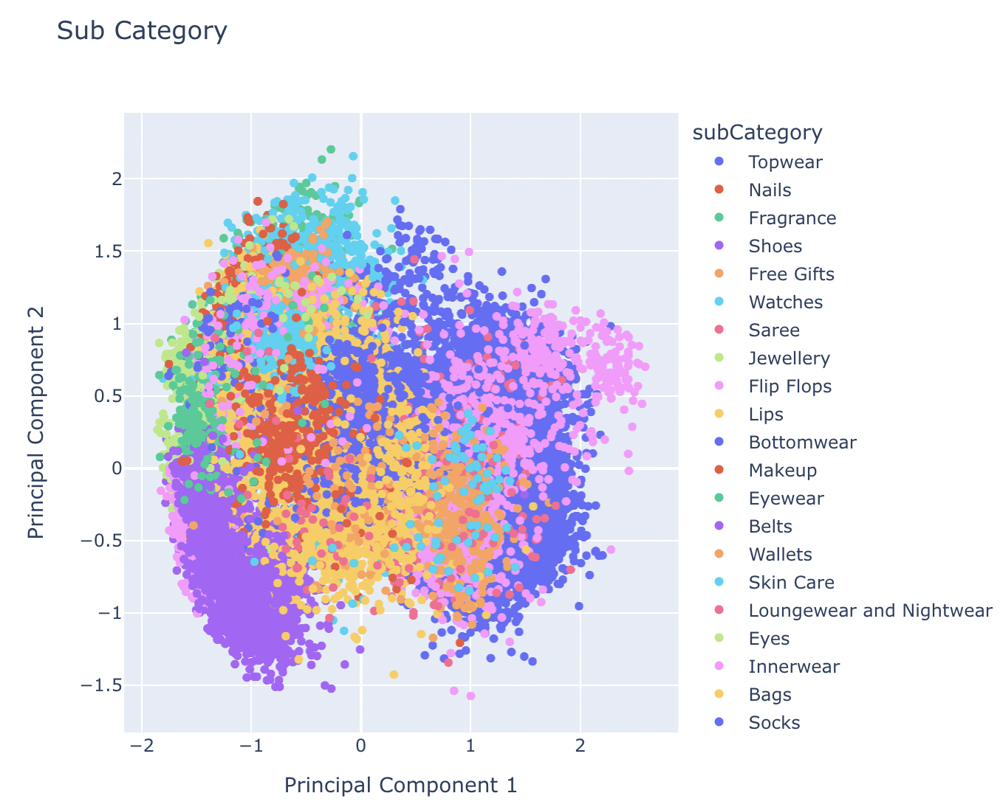

In [ ]:
fig = px.scatter(train[train['season'].notna()], x=0, y=1, color="season", title='Season', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

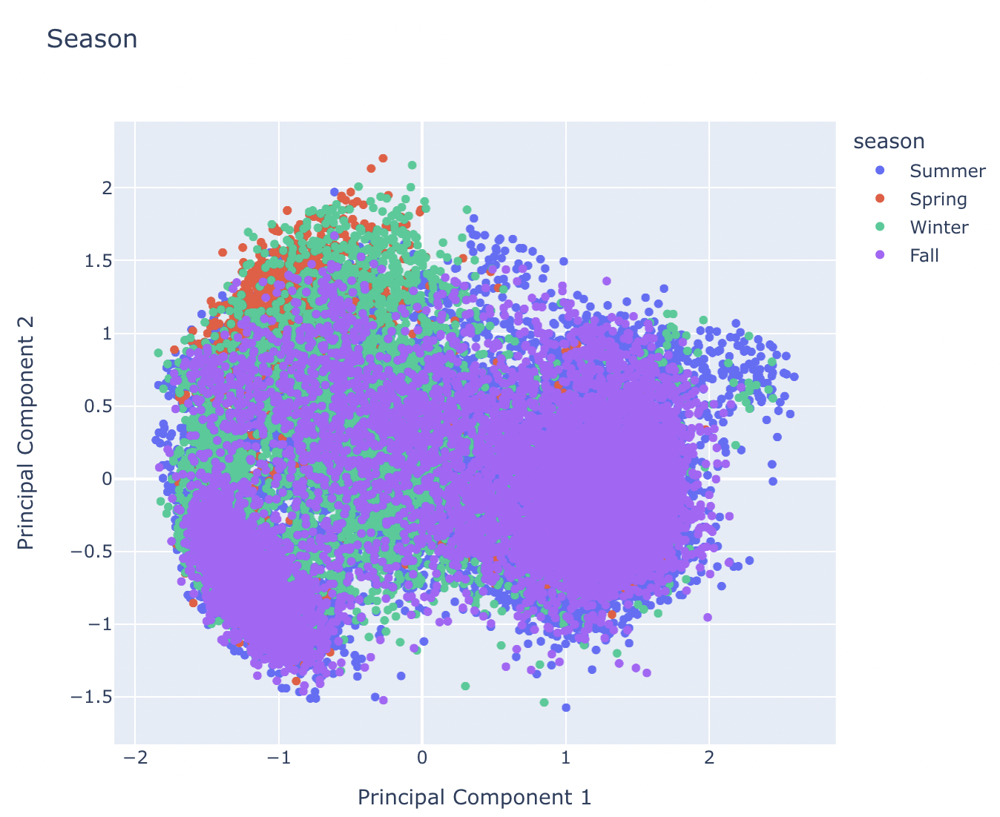

In [ ]:
fig = px.scatter(train[train['usage'].notna()], x=0, y=1, color="usage", title='Usage', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

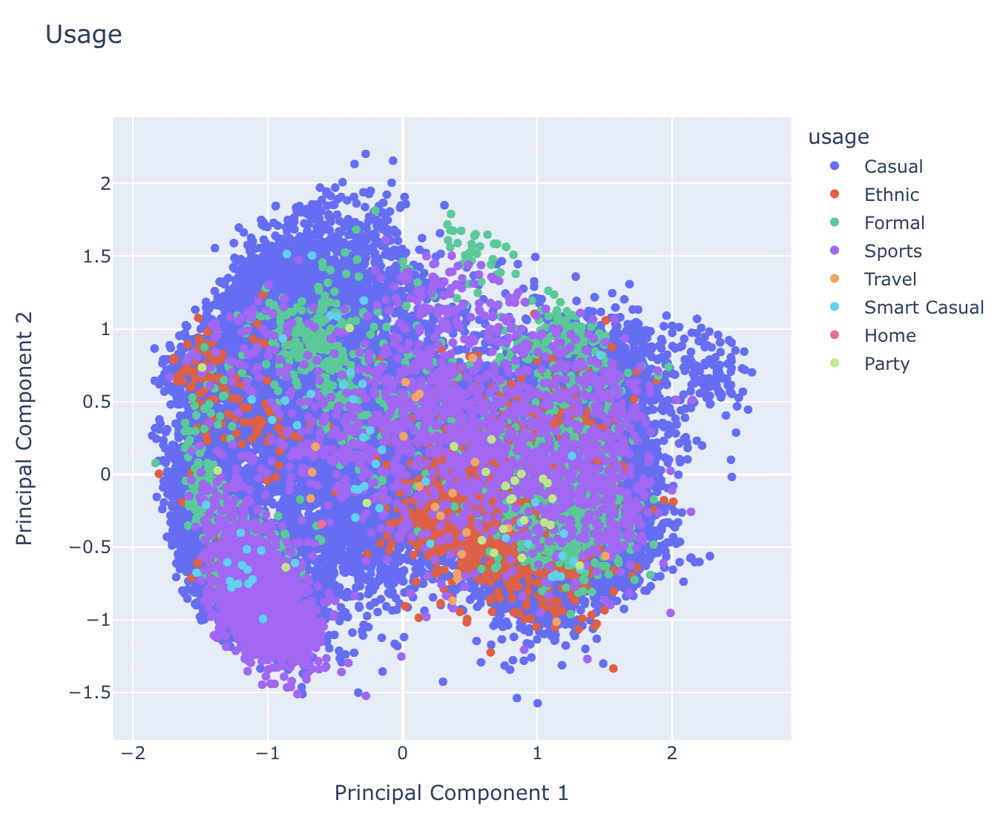

In [ ]:
pca = PCA()
pca.fit(train_features)
train_pca = pca.transform(train_features)
variance_explained = np.cumsum(pca.explained_variance_ratio_)
pcs = range(1,len(variance_explained)+1)

In [ ]:
px.line(x = pcs, y = variance_explained, title = 'Principal Components Cumulative Explained Variance', height=600,  labels={
                     "x": "Principal Components",
                     "y": "Explained Variance"})

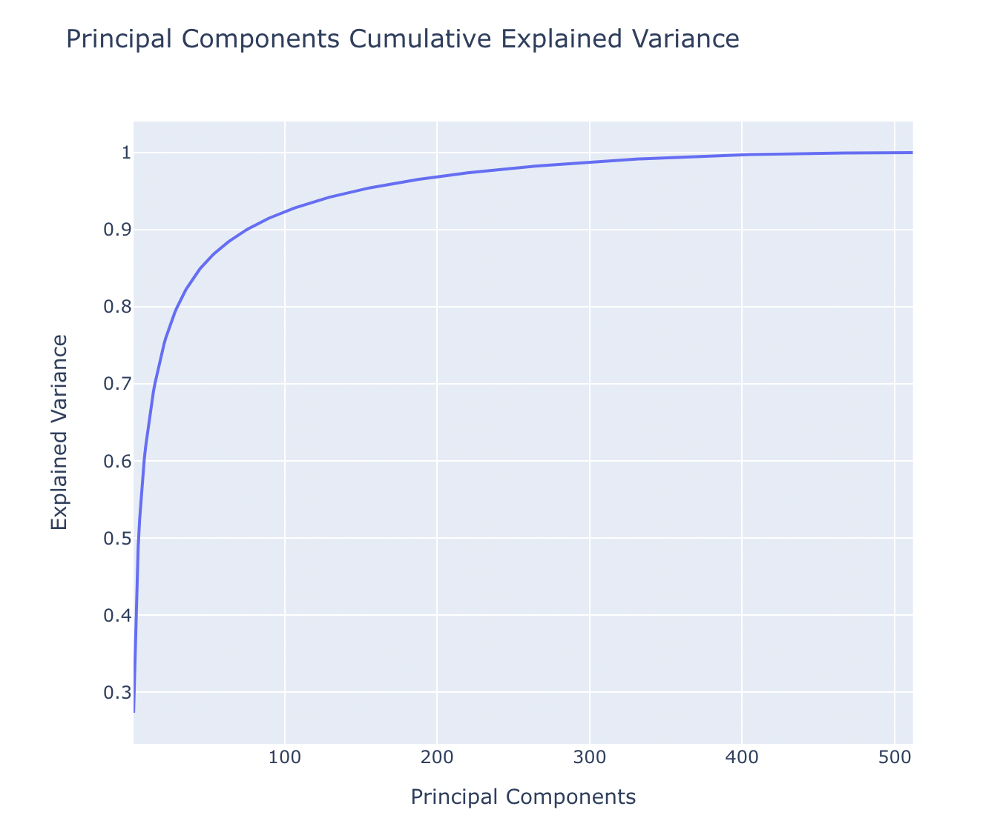

In [ ]:
val_pca = pca.fit_transform(val_features)[:,:313]
val_pca = pd.DataFrame(val_pca)
val = val.iloc[:,0:10]
val = val.merge(val_pca, how='left', left_index=True, right_index=True)

In [ ]:
X = val.iloc[:,-313:]
y = val['id']

## K-Nearest Neighbors

We can now look at the 5 most similar products based on raw extracted features from the pre-trained network.
We will not use the predict method for classification prediction, but the KNeighbours method to find the k or 6 most nearest neighbours which have visually similar content.

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=6)
neigh.fit(X, y)

KNeighborsClassifier(n_neighbors=6)

In [ ]:
pickle.dump(neigh, open('model.pkl','wb'))

In [ ]:
def read_img(image_path):
    image = load_img(image_path,target_size=(256,256,3))
    image = img_to_array(image)
    image = image/255.
    return image

## Results

In [ ]:
import random

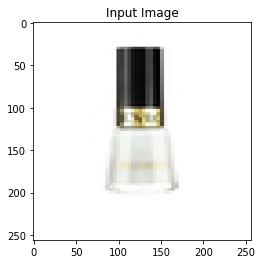

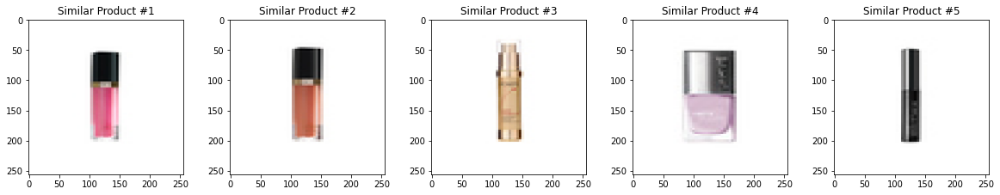

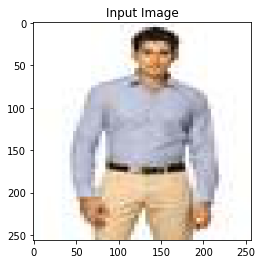

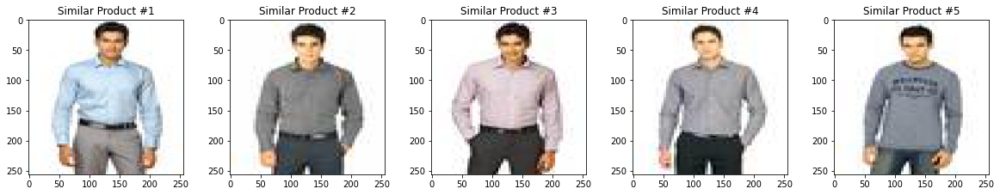

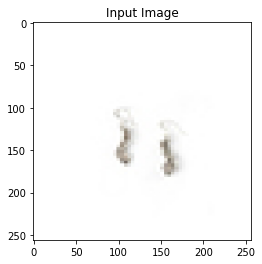

...

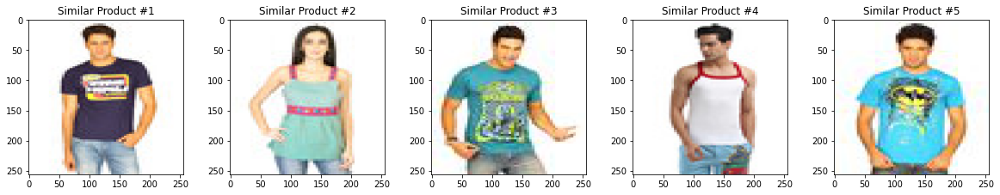

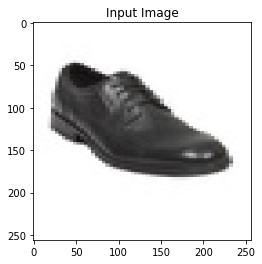

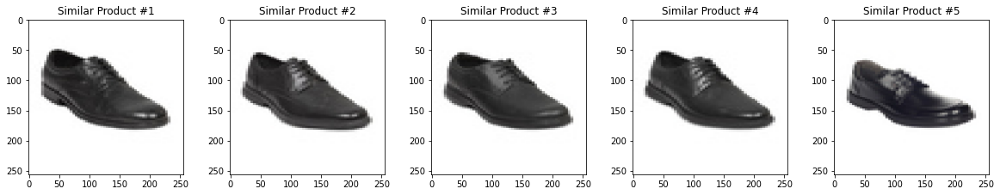

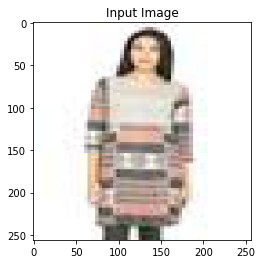

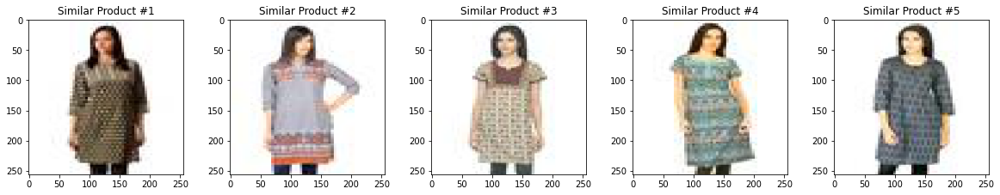

In [ ]:
for _ in range(10):
    i = random.randint(1,len(val))
    img1 = read_img(val.loc[i,'filename'])
    dist, index = neigh.kneighbors(X=X.iloc[i,:].values.reshape(1,-1))
    plt.figure(figsize = (4 , 4))
    plt.imshow(img1)
    plt.title("Input Image")

    plt.figure(figsize = (20 , 20))
    for i in range(1,6):
        plt.subplot(1 , 5, i)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        image = read_img(val.loc[index[0][i],'filename'])
        plt.imshow(image)
        plt.title(f'Similar Product #{i}')